<a href="https://colab.research.google.com/github/nguyen1oc/CROWD_COUNTING/blob/main/CROWD_COUNTING_USING_YOLOv11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#IMPORT


In [4]:
import os
import requests
import zipfile
import requests
from google.colab import drive
import numpy as np
from scipy.io import loadmat #dung de doc file .mat
import cv2
import scipy.io
from PIL import Image
import random
import shutil
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.neighbors import NearestNeighbors
import torch
import pandas as pd

In [2]:
!find /content -mindepth 1 -maxdepth 1 -exec rm -rf {} + #Xóa các thư mục

#DOWNLOAD DATASET


In [3]:
download_path = "/content/drive/MyDrive/ShanghaiTech_Download"
extract_path = "/content/drive/MyDrive/ShanghaiTech"

# Tạo thư mục lưu file và giải nén nếu chưa tồn tại
print("Kiểm tra và tạo thư mục...")
os.makedirs(download_path, exist_ok=True)
os.makedirs(extract_path, exist_ok=True)

# Link tải dataset từ Dropbox (lấy từ Papers with Code)
url = "https://www.dropbox.com/scl/fi/dkj5kulc9zj0rzesslck8/ShanghaiTech_Crowd_Counting_Dataset.zip?rlkey=ymbcj50ac04uvqn8p49j9af5f&dl=1"

# Đường dẫn để lưu file tải về
file_path = os.path.join(download_path, "ShanghaiTech_Crowd_Counting_Dataset.zip")

# Tải file từ Dropbox
print(f"Đang tải dataset từ {url}...")
response = requests.get(url, stream=True)
if response.status_code == 200:
    with open(file_path, 'wb') as f:
        for chunk in response.iter_content(chunk_size=8192):
            if chunk:
                f.write(chunk)
    print(f"Dataset đã được tải về tại {file_path}")
else:
    print(f"Lỗi khi tải file: HTTP Status Code {response.status_code}")
    print("Vui lòng kiểm tra lại link hoặc thử link Baidu Cloud Disk: https://pan.baidu.com/s/1xJnhmJbwPdnNKBM1K6F1Cg?pwd=iga3 (mật khẩu: iga3)")

# Giải nén file
if os.path.exists(file_path):
    print(f"Đang giải nén {file_path}...")
    with zipfile.ZipFile(file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
    print(f"Dataset đã được giải nén tại {extract_path}")
else:
    print("File không tồn tại để giải nén. Vui lòng kiểm tra lại bước tải.")

# Kiểm tra nội dung thư mục giải nén
part_a_path = os.path.join(extract_path, "part_A_final")
if os.path.exists(part_a_path):
    print("Nội dung thư mục part_A_final:")
    !ls "/content/drive/MyDrive/ShanghaiTech/part_A_final"
else:
    print("Thư mục part_A_final không tồn tại. Vui lòng kiểm tra lại quá trình giải nén.")

Kiểm tra và tạo thư mục...
Đang tải dataset từ https://www.dropbox.com/scl/fi/dkj5kulc9zj0rzesslck8/ShanghaiTech_Crowd_Counting_Dataset.zip?rlkey=ymbcj50ac04uvqn8p49j9af5f&dl=1...
Dataset đã được tải về tại /content/drive/MyDrive/ShanghaiTech_Download/ShanghaiTech_Crowd_Counting_Dataset.zip
Đang giải nén /content/drive/MyDrive/ShanghaiTech_Download/ShanghaiTech_Crowd_Counting_Dataset.zip...
Dataset đã được giải nén tại /content/drive/MyDrive/ShanghaiTech
Nội dung thư mục part_A_final:
test_data  train_data


#PREPROCESSING

In [4]:
# Đọc file ground truth
mat = scipy.io.loadmat('/content/drive/MyDrive/ShanghaiTech/part_A_final/train_data/ground_truth/GT_IMG_1.mat')
points = mat["image_info"][0][0][0][0][0]  # lấy list điểm (tọa độ x, y)

# In thử 5 điểm đầu
for p in points[:5]:
    print(p)


[ 29.6225116  472.92022152]
[ 54.35533603 454.96602305]
[ 51.79045053 460.46220626]
[ 51.79045053 465.77518336]
[ 50.87442    473.65304595]


In [5]:
dataset_part = "/content/drive/MyDrive/ShanghaiTech/part_A_final"
output_path = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset"

# Đường dẫn tới ảnh và ground-truth
img_dir_train = os.path.join(dataset_part, "train_data", "images")
gt_dir_train = os.path.join(dataset_part, "train_data", "ground_truth")

img_dir_test = os.path.join(dataset_part, "test_data", "images")
gt_dir_test = os.path.join(dataset_part, "test_data", "ground_truth")

# Hàm tính khoảng cách trung bình giữa các điểm gần nhất
def estimate_head_size(points, k=3):
    if len(points) < 2:
        return 20  # Giá trị mặc định nếu không đủ điểm để tính

    # Sử dụng NearestNeighbors để tìm khoảng cách đến k điểm gần nhất
    nbrs = NearestNeighbors(n_neighbors=min(k, len(points)), algorithm='auto').fit(points)
    distances, _ = nbrs.kneighbors(points)

    # Lấy khoảng cách trung bình đến k điểm gần nhất (bỏ khoảng cách đến chính nó)
    avg_distances = np.mean(distances[:, 1:], axis=1)
    avg_head_size = np.mean(avg_distances)  # Trung bình toàn bộ ảnh

    return max(15, min(50, avg_head_size))  # Giới hạn box_size trong khoảng [15, 50]

# Hàm chuyển đổi annotation từ .mat sang YOLO với box_size động
def convert_mat_to_yolo(img_dir, gt_dir, output_img_dir, output_lbl_dir, k_neighbors=3):
    os.makedirs(output_img_dir, exist_ok=True)
    os.makedirs(output_lbl_dir, exist_ok=True)

    for img_name in os.listdir(img_dir):
        if not img_name.endswith('.jpg'):
            continue

        img_path = os.path.join(img_dir, img_name)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Không thể đọc ảnh {img_path}")
            continue

        h, w = img.shape[:2]
        gt_path = os.path.join(gt_dir, f"GT_{img_name.replace('.jpg', '.mat')}")
        if not os.path.exists(gt_path):
            print(f"Không tìm thấy ground-truth {gt_path}")
            continue

        mat = loadmat(gt_path)
        points = mat['image_info'][0, 0][0, 0][0]

        # Ước lượng kích thước đầu người dựa trên khoảng cách giữa các điểm
        box_size = estimate_head_size(points, k=k_neighbors)
        print(f"Image {img_name}: Estimated box_size = {box_size}")

        # Ghi file label
        label_path = os.path.join(output_lbl_dir, img_name.replace('.jpg', '.txt'))
        seen_points = set()
        with open(label_path, 'w') as f:
            for point in points:
                x, y = point
                # Chuẩn hóa tọa độ
                x_center = x / w
                y_center = y / h
                # Giới hạn tọa độ trong khoảng [0, 1]
                x_center = max(0, min(1, x_center))
                y_center = max(0, min(1, y_center))
                box_w = box_h = box_size / w  # square box
                # Đảm bảo box_w, box_h không âm
                box_w = max(0, min(1, box_w))
                box_h = max(0, min(1, box_h))

                # Kiểm tra nhãn trùng lặp
                label_tuple = (x_center, y_center)
                if label_tuple in seen_points:
                    print(f"Duplicate label in {img_name}: {x_center}, {y_center}")
                    continue
                seen_points.add(label_tuple)

                f.write(f"0 {x_center:.6f} {y_center:.6f} {box_w:.6f} {box_h:.6f}\n")

        output_img_path = os.path.join(output_img_dir, img_name)
        cv2.imwrite(output_img_path, img)


In [6]:
# Chuyển đổi dữ liệu train
convert_mat_to_yolo(
    img_dir_train,
    gt_dir_train,
    os.path.join(output_path, "images", "train"),
    os.path.join(output_path, "labels", "train"),
    k_neighbors=3
)

# Chuyển đổi dữ liệu test
convert_mat_to_yolo(
    img_dir_test,
    gt_dir_test,
    os.path.join(output_path, "images", "test"),
    os.path.join(output_path, "labels", "test"),
    k_neighbors=3
)

Image IMG_263.jpg: Estimated box_size = 15
Image IMG_57.jpg: Estimated box_size = 21.2365279624576
Image IMG_257.jpg: Estimated box_size = 16.405673299584322
Image IMG_22.jpg: Estimated box_size = 21.416186780831556
Image IMG_122.jpg: Estimated box_size = 16.902399823360792
Image IMG_269.jpg: Estimated box_size = 18.19675976182703
Image IMG_141.jpg: Estimated box_size = 50
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 

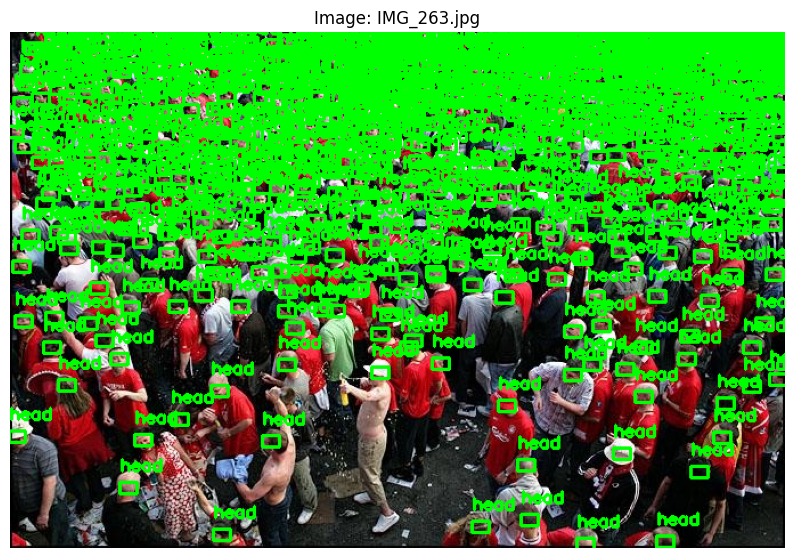

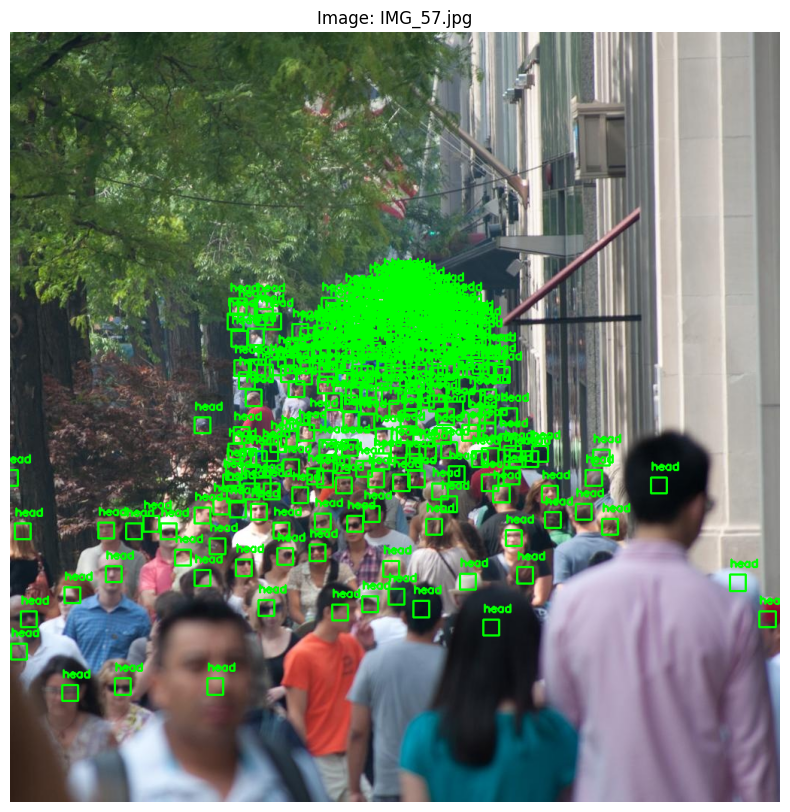

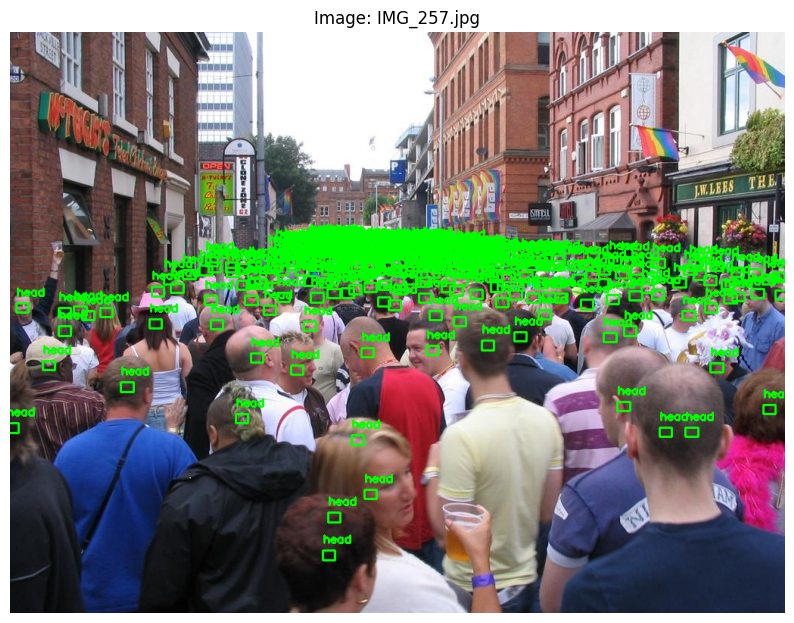

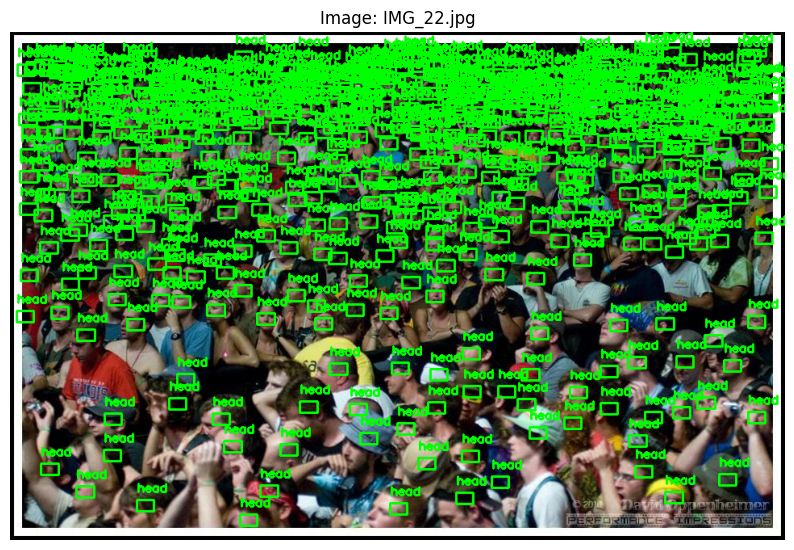

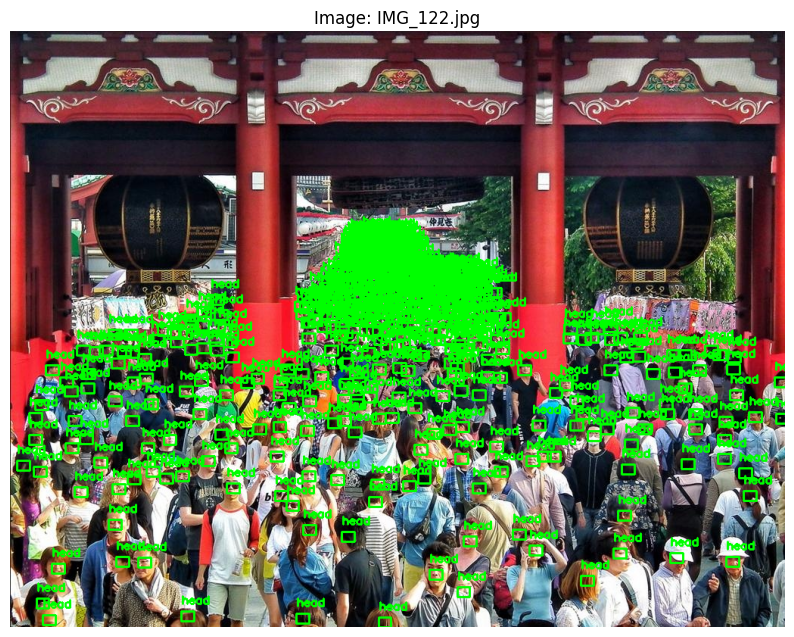

In [7]:
output_img_dir = os.path.join(output_path, "images", "train")
output_lbl_dir = os.path.join(output_path, "labels", "train")

# Hàm visualize hình ảnh với bounding box
def visualize_yolo_labels(img_dir, lbl_dir, num_images=5):
    img_files = [f for f in os.listdir(img_dir) if f.endswith('.jpg')]

    for img_name in img_files[:num_images]:
        # Đọc ảnh
        img_path = os.path.join(img_dir, img_name)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Không thể đọc ảnh {img_path}")
            continue

        h, w = img.shape[:2]

        # Đọc file nhãn
        label_path = os.path.join(lbl_dir, img_name.replace('.jpg', '.txt'))
        if not os.path.exists(label_path):
            print(f"Không tìm thấy nhãn {label_path}")
            continue

        # Đọc các bounding box từ file nhãn
        with open(label_path, 'r') as f:
            labels = f.readlines()

        # Vẽ bounding box lên ảnh
        for label in labels:
            class_id, x_center, y_center, box_w, box_h = map(float, label.strip().split())

            # Chuyển đổi tọa độ từ dạng chuẩn hóa về pixel
            x_center = x_center * w
            y_center = y_center * h
            box_w = box_w * w
            box_h = box_h * h

            x1 = int(x_center - box_w / 2)
            y1 = int(y_center - box_h / 2)
            x2 = int(x_center + box_w / 2)
            y2 = int(y_center + box_h / 2)

            # Vẽ bounding box lên ảnh
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(img, "head", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Chuyển đổi màu từ BGR (OpenCV) sang RGB (Matplotlib)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Hiển thị ảnh
        plt.figure(figsize=(10, 10))
        plt.imshow(img_rgb)
        plt.title(f"Image: {img_name}")
        plt.axis('off')
        plt.show()

# Gọi hàm để visualize 5 ảnh đầu tiên
visualize_yolo_labels(output_img_dir, output_lbl_dir, num_images=5)

In [8]:
!cat /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train/IMG_282.txt

0 1.000000 0.409427 0.025055 0.025055
0 0.000000 0.344554 0.025055 0.025055
0 1.000000 0.249617 0.025055 0.025055
0 0.331794 0.659427 0.025055 0.025055
0 0.334167 0.615124 0.025055 0.025055
0 0.342474 0.578731 0.025055 0.025055
0 0.367395 0.586643 0.025055 0.025055
0 0.385196 0.559744 0.025055 0.025055
0 0.387569 0.630946 0.025055 0.025055
0 0.431477 0.583478 0.025055 0.025055
0 0.430291 0.567655 0.025055 0.025055
0 0.475385 0.556579 0.025055 0.025055
0 0.457585 0.531263 0.025055 0.025055
0 0.496746 0.534427 0.025055 0.025055
0 0.516920 0.556579 0.025055 0.025055
0 0.499120 0.558162 0.025055 0.025055
0 0.506240 0.605630 0.025055 0.025055
0 0.496746 0.634111 0.025055 0.025055
0 0.493186 0.670503 0.025055 0.025055
0 0.056477 0.874617 0.025055 0.025055
0 0.048170 0.955314 0.025055 0.025055
0 0.022063 0.806579 0.025055 0.025055
0 0.093265 0.784427 0.025055 0.025055
0 0.016129 0.705314 0.025055 0.025055
0 0.009009 0.634111 0.025055 0.025055
0 0.009009 0.548668 0.025055 0.025055
0 0.027996 0

In [9]:
base_path = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset"
train_img_dir = os.path.join(base_path, "images","train")
train_lbl_dir = os.path.join(base_path, "labels","train")

val_img_dir = os.path.join(base_path, "images","valid")
val_lbl_dir = os.path.join(base_path, "labels","valid")

# Tạo thư mục valid
os.makedirs(val_img_dir, exist_ok=True)
os.makedirs(val_lbl_dir, exist_ok=True)

# Danh sách ảnh trong train
image_files = [f for f in os.listdir(train_img_dir) if f.endswith('.jpg')]
random.seed(42)
val_size = int(0.2 * len(image_files))  # 20%
val_files = random.sample(image_files, val_size)

# Di chuyển ảnh và label
for img_name in val_files:
    label_name = img_name.replace('.jpg', '.txt')

    # Di chuyển ảnh
    shutil.move(os.path.join(train_img_dir, img_name), os.path.join(val_img_dir, img_name))

    # Di chuyển nhãn (nếu có)
    src_label = os.path.join(train_lbl_dir, label_name)
    if os.path.exists(src_label):
        shutil.move(src_label, os.path.join(val_lbl_dir, label_name))

print(f"Đã chuyển {val_size} ảnh + label từ train_data sang valid_data.")

Đã chuyển 60 ảnh + label từ train_data sang valid_data.


In [10]:
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/train | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/valid | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/valid | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/test | wc -l

241
241
61
61
183
183


#TRAIN AND VALID


In [11]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 974.5/974.5 kB 42.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 68.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 60.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 42.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 85.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [12]:
import ultralytics
print(ultralytics.__version__)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
8.3.107


In [13]:
yaml_content = """
train: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/train
val: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/valid
test: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test

nc: 1
names: ['head']
"""

with open("yolov11_dataset.yaml", "w") as f:
    f.write(yaml_content)


In [1]:
from ultralytics import YOLO
model = YOLO("yolo11n.pt")
results = model.train(data="yolov11_dataset.yaml",
                      epochs=100,
                      imgsz=640,
                      device = 0,
                      close_mosaic=1 ,
                      batch = 4,
                      augment = True,
                      stream_buffer = True,
                      cache = "disk",
                      dropout = 0.3,
                      iou = 0.7,
                      optimizer = 'AdamW',
                      lr0 = 0.001,
                      patience=20,
                      nms = True)

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=yolov11_dataset.yaml, epochs=100, time=None, patience=20, batch=4, imgsz=640, save=True, save_period=-1, cache=disk, device=0, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=1, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.3, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=True, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format

train: Scanning /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train... 240 images, 0 backgrounds, 0 corrupt: 100%|██████████| 240/240 [00:01<00:00, 220.94it/s]

train: WARNING ⚠️ /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/train/IMG_76.jpg: 1 duplicate labels removed
train: New cache created: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train.cache



train: Caching images (0.4GB Disk): 100%|██████████| 240/240 [00:02<00:00, 112.34it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/valid... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 150.32it/s]


val: New cache created: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/valid.cache


val: Caching images (0.1GB Disk): 100%|██████████| 60/60 [00:01<00:00, 51.04it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.33G      3.917       2.24      1.359       2225        640: 100%|██████████| 60/60 [00:18<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]

                   all         60      33117      0.195      0.106      0.117     0.0335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.35G      3.628      1.782        1.2       3898        640: 100%|██████████| 60/60 [00:12<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.97it/s]


                   all         60      33117     0.0252     0.0137     0.0177    0.00487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      9.53G      3.577      1.726      1.213       2772        640: 100%|██████████| 60/60 [00:12<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]

                   all         60      33117      0.269      0.146      0.171     0.0514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      9.55G      3.571      1.681      1.172       1552        640: 100%|██████████| 60/60 [00:13<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


                   all         60      33117      0.188        0.1      0.108     0.0297

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      9.56G      3.583      1.675      1.177       3736        640: 100%|██████████| 60/60 [00:13<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


                   all         60      33117      0.271      0.145      0.164     0.0515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      9.58G      3.448      1.624      1.164       1775        640: 100%|██████████| 60/60 [00:13<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.91it/s]


                   all         60      33117      0.321      0.172      0.208     0.0641

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      9.59G      3.453       1.64      1.172       1596        640: 100%|██████████| 60/60 [00:12<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


                   all         60      33117      0.292      0.156      0.184     0.0548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      9.61G      3.443      1.601      1.157       4424        640: 100%|██████████| 60/60 [00:13<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.92it/s]


                   all         60      33117      0.287      0.153      0.178     0.0544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      9.62G      3.439      1.604      1.153       1299        640: 100%|██████████| 60/60 [00:12<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.91it/s]


                   all         60      33117      0.268      0.144      0.172     0.0528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      9.64G      3.371      1.596      1.151       5624        640: 100%|██████████| 60/60 [00:12<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.00it/s]

                   all         60      33117      0.326      0.175      0.215     0.0678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      9.65G      3.308      1.537      1.135       2459        640: 100%|██████████| 60/60 [00:12<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.84it/s]

                   all         60      33117      0.298      0.159       0.19      0.059



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      9.67G       3.36      1.552      1.131       3141        640: 100%|██████████| 60/60 [00:13<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.89it/s]

                   all         60      33117      0.309      0.167      0.205     0.0649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      9.68G      3.312      1.563      1.134       4551        640: 100%|██████████| 60/60 [00:12<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all         60      33117       0.36      0.194      0.239     0.0779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       9.7G      3.302      1.547      1.112       5203        640: 100%|██████████| 60/60 [00:12<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117      0.353      0.189      0.231     0.0747

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      9.71G      3.308      1.515      1.133       3807        640: 100%|██████████| 60/60 [00:12<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.39it/s]

                   all         60      33117      0.353       0.19      0.235     0.0765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      13.2G      3.233      1.515      1.107       1658        640: 100%|██████████| 60/60 [00:13<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.70it/s]


                   all         60      33117      0.377      0.202      0.256     0.0823

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      13.2G      3.241      1.549      1.122       4309        640: 100%|██████████| 60/60 [00:12<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.359      0.192      0.234     0.0766

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      13.2G      3.291       1.52      1.119       2645        640: 100%|██████████| 60/60 [00:12<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]


                   all         60      33117      0.365      0.193      0.233     0.0758

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      13.2G       3.26      1.473      1.098       4983        640: 100%|██████████| 60/60 [00:13<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


                   all         60      33117      0.389      0.207      0.257     0.0816

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      13.2G      3.141      1.467      1.102       3017        640: 100%|██████████| 60/60 [00:13<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.37it/s]

                   all         60      33117      0.381      0.203      0.255     0.0819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      13.3G      3.181      1.479      1.104       3470        640: 100%|██████████| 60/60 [00:13<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.54it/s]


                   all         60      33117      0.389      0.207      0.254     0.0831

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      13.3G      3.167      1.468      1.119       4378        640: 100%|██████████| 60/60 [00:13<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.96it/s]


                   all         60      33117       0.37      0.197      0.243     0.0773

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      6.37G      3.104      1.461      1.104       3417        640: 100%|██████████| 60/60 [00:12<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117      0.402      0.212       0.27     0.0894

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      6.37G       3.11      1.451      1.081       3184        640: 100%|██████████| 60/60 [00:12<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


                   all         60      33117      0.395      0.211      0.268     0.0868

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      10.1G      3.176      1.476      1.092       2639        640: 100%|██████████| 60/60 [00:13<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.04it/s]

                   all         60      33117      0.331      0.178      0.217     0.0673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      10.1G      3.135      1.454      1.098       2207        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117      0.374        0.2      0.245     0.0835

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      10.1G      3.073      1.453      1.084       2141        640: 100%|██████████| 60/60 [00:12<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.81it/s]

                   all         60      33117      0.406      0.212      0.269     0.0877



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      10.1G      3.118      1.451      1.116       2162        640: 100%|██████████| 60/60 [00:12<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.92it/s]


                   all         60      33117      0.314      0.167      0.198     0.0612

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      10.1G      3.174      1.435      1.097       2471        640: 100%|██████████| 60/60 [00:13<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.83it/s]


                   all         60      33117      0.378        0.2      0.248     0.0814

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      10.1G      3.132      1.459      1.069       2945        640: 100%|██████████| 60/60 [00:13<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.05it/s]

                   all         60      33117      0.403      0.212      0.271     0.0887



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      10.1G      3.096      1.422      1.086       2085        640: 100%|██████████| 60/60 [00:12<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.373      0.198      0.251     0.0829

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      10.1G      3.111      1.442      1.087       4408        640: 100%|██████████| 60/60 [00:12<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


                   all         60      33117      0.407      0.217      0.278     0.0931

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      12.6G       3.17      1.439      1.095       4372        640: 100%|██████████| 60/60 [00:13<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]

                   all         60      33117      0.387      0.206       0.25     0.0826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      9.56G      3.048      1.411      1.068       2785        640: 100%|██████████| 60/60 [00:13<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]

                   all         60      33117      0.398      0.211      0.261     0.0845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      9.57G      3.048      1.432       1.09       3699        640: 100%|██████████| 60/60 [00:12<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all         60      33117       0.39      0.206      0.259     0.0867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      9.59G      3.128      1.448      1.086       3805        640: 100%|██████████| 60/60 [00:13<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


                   all         60      33117      0.422      0.223      0.289        0.1

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100       9.6G      3.014      1.409      1.078       3604        640: 100%|██████████| 60/60 [00:13<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


                   all         60      33117      0.427      0.228      0.297      0.101

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      9.62G       3.07      1.433      1.083       2317        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.91it/s]


                   all         60      33117      0.392      0.207      0.264     0.0883

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      12.6G       3.12      1.421      1.074       3963        640: 100%|██████████| 60/60 [00:13<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.60it/s]

                   all         60      33117      0.409      0.214      0.274     0.0914



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      12.6G      3.085      1.418      1.071       3309        640: 100%|██████████| 60/60 [00:12<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


                   all         60      33117      0.392      0.204      0.257     0.0821

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      12.6G      3.186      1.415      1.132       3099        640: 100%|██████████| 60/60 [00:13<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


                   all         60      33117      0.417      0.224      0.288     0.0974

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      9.99G      3.076      1.434      1.079       1657        640: 100%|██████████| 60/60 [00:13<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


                   all         60      33117      0.385      0.205       0.26     0.0908

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100        10G      3.094      1.413      1.081       4269        640: 100%|██████████| 60/60 [00:13<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


                   all         60      33117      0.417      0.221      0.285     0.0965

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100        10G      2.998       1.42      1.061       3376        640: 100%|██████████| 60/60 [00:12<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.41it/s]

                   all         60      33117      0.409      0.217      0.282     0.0955



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100        10G      3.057       1.41      1.071       2562        640: 100%|██████████| 60/60 [00:13<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]


                   all         60      33117      0.383      0.202      0.256     0.0856

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100        10G       3.04      1.423      1.077       4375        640: 100%|██████████| 60/60 [00:13<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


                   all         60      33117      0.432      0.228      0.297      0.098

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      10.1G      3.006      1.405      1.082       2331        640: 100%|██████████| 60/60 [00:12<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


                   all         60      33117      0.413      0.221      0.285     0.0916

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      10.1G      3.077      1.429      1.081       2629        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117      0.322      0.173      0.214     0.0692

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      10.1G      3.094      1.425      1.082       2054        640: 100%|██████████| 60/60 [00:13<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.43it/s]

                   all         60      33117      0.412      0.214      0.278     0.0903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      10.1G      3.032      1.408      1.079       2964        640: 100%|██████████| 60/60 [00:12<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.48it/s]


                   all         60      33117      0.428      0.227      0.291     0.0995

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      10.1G      3.001      1.385      1.068       8812        640: 100%|██████████| 60/60 [00:12<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


                   all         60      33117      0.428      0.228      0.289     0.0969

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      10.1G      2.954      1.403      1.073       7376        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117       0.43      0.226       0.29     0.0987

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      10.2G      2.987      1.379      1.065       2105        640: 100%|██████████| 60/60 [00:12<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


                   all         60      33117      0.443      0.232      0.302     0.0991

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      10.2G      3.031      1.412      1.061       3511        640: 100%|██████████| 60/60 [00:13<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.52it/s]

                   all         60      33117      0.355      0.189      0.234     0.0786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      10.2G      3.087      1.407      1.078       3283        640: 100%|██████████| 60/60 [00:13<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.41it/s]

                   all         60      33117      0.434      0.227      0.302      0.102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      10.2G      2.934      1.375      1.055       3292        640: 100%|██████████| 60/60 [00:12<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.92it/s]

                   all         60      33117      0.422      0.225      0.294     0.0989



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      10.2G      3.006      1.392      1.067       3974        640: 100%|██████████| 60/60 [00:13<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117      0.427      0.225      0.296     0.0988

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      10.2G      2.932        1.4       1.09       1401        640: 100%|██████████| 60/60 [00:12<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]

                   all         60      33117      0.437       0.23      0.297        0.1



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      10.2G      2.924       1.37      1.034       3632        640: 100%|██████████| 60/60 [00:12<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.70it/s]

                   all         60      33117      0.443      0.234      0.305      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      10.3G       2.98      1.382      1.066       2405        640: 100%|██████████| 60/60 [00:12<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


                   all         60      33117      0.413      0.221      0.289      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      10.3G      2.959      1.434      1.076       5173        640: 100%|██████████| 60/60 [00:12<00:00,  4.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.421      0.226      0.296      0.105

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      10.3G      2.958      1.369      1.059       4449        640: 100%|██████████| 60/60 [00:13<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]

                   all         60      33117      0.443      0.232      0.306      0.102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      10.3G      2.987      1.384      1.048       2981        640: 100%|██████████| 60/60 [00:12<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


                   all         60      33117      0.414      0.218      0.276     0.0946

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      10.3G      2.891      1.356      1.036       4355        640: 100%|██████████| 60/60 [00:13<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.94it/s]

                   all         60      33117      0.447       0.23      0.301     0.0987



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      13.9G      2.934      1.354      1.049       4818        640: 100%|██████████| 60/60 [00:12<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all         60      33117      0.433      0.227      0.298      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      10.9G      2.922      1.349      1.034       2258        640: 100%|██████████| 60/60 [00:13<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117      0.438      0.231      0.307      0.103

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      10.9G      2.947      1.351      1.085       2311        640: 100%|██████████| 60/60 [00:12<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.96it/s]

                   all         60      33117      0.436      0.232      0.304      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      10.9G      2.976      1.382      1.051       2687        640: 100%|██████████| 60/60 [00:13<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


                   all         60      33117      0.453      0.238      0.316      0.109

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      10.9G      2.934      1.354      1.063       2633        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.27it/s]

                   all         60      33117      0.439      0.232      0.303      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      10.9G      2.962      1.368      1.044       3137        640: 100%|██████████| 60/60 [00:13<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.85it/s]

                   all         60      33117      0.445      0.234      0.307      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      10.9G      2.904      1.358       1.08       4002        640: 100%|██████████| 60/60 [00:12<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.89it/s]


                   all         60      33117      0.444      0.236       0.31      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      10.9G      2.879       1.34      1.043       4419        640: 100%|██████████| 60/60 [00:13<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.91it/s]

                   all         60      33117      0.402      0.214      0.275     0.0949



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      10.9G      2.907      1.354      1.057       3749        640: 100%|██████████| 60/60 [00:12<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]

                   all         60      33117      0.457      0.239      0.319      0.111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      10.9G      2.903      1.343      1.046       4323        640: 100%|██████████| 60/60 [00:13<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.06it/s]

                   all         60      33117      0.431      0.227      0.297      0.103



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      10.9G      2.946      1.365      1.045       5533        640: 100%|██████████| 60/60 [00:13<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]


                   all         60      33117       0.45      0.235      0.309      0.108

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      10.9G      2.908      1.336      1.041       2879        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.447      0.234      0.308      0.107

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      10.9G      2.847      1.349      1.054       2388        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.85it/s]


                   all         60      33117      0.464      0.241      0.321       0.11

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      10.9G      2.799      1.346      1.041       1849        640: 100%|██████████| 60/60 [00:12<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.459       0.24      0.316       0.11

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      10.9G      2.853      1.333      1.039       3988        640: 100%|██████████| 60/60 [00:13<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.03it/s]

                   all         60      33117      0.451      0.239      0.315      0.108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      10.9G      2.851      1.361      1.076       4113        640: 100%|██████████| 60/60 [00:12<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.84it/s]


                   all         60      33117      0.447      0.238      0.312      0.106

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      10.9G      2.831       1.34      1.051       2514        640: 100%|██████████| 60/60 [00:12<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


                   all         60      33117      0.452      0.239      0.316      0.108

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      10.9G      2.886      1.348       1.05       6460        640: 100%|██████████| 60/60 [00:12<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.445      0.236      0.311      0.105

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      10.9G      2.881      1.337      1.041       1642        640: 100%|██████████| 60/60 [00:12<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.92it/s]


                   all         60      33117      0.429      0.228      0.298      0.104

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      10.9G      2.856      1.353      1.044       1126        640: 100%|██████████| 60/60 [00:13<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all         60      33117      0.441      0.235      0.309      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      10.9G      2.825      1.323      1.047       2667        640: 100%|██████████| 60/60 [00:12<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.17it/s]


                   all         60      33117      0.444      0.236      0.312       0.11

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      10.9G      2.935      1.353      1.046       1756        640: 100%|██████████| 60/60 [00:12<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.97it/s]

                   all         60      33117      0.419      0.222       0.29     0.0994



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      10.9G      2.857      1.336      1.046       3961        640: 100%|██████████| 60/60 [00:12<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.96it/s]

                   all         60      33117      0.454      0.239      0.317      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      10.9G      2.863      1.325      1.083       8711        640: 100%|██████████| 60/60 [00:12<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.91it/s]

                   all         60      33117      0.452      0.239      0.318      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      10.9G      2.889      1.351      1.045       4748        640: 100%|██████████| 60/60 [00:12<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]


                   all         60      33117      0.441      0.234       0.31      0.109

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      10.9G       2.82      1.321      1.027       3235        640: 100%|██████████| 60/60 [00:13<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.38it/s]

                   all         60      33117      0.448      0.236      0.316      0.111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      10.9G      2.781      1.336      1.067       3563        640: 100%|██████████| 60/60 [00:12<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.51it/s]


                   all         60      33117      0.448      0.235      0.314      0.112

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      10.9G       2.78      1.338      1.048       3220        640: 100%|██████████| 60/60 [00:12<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


                   all         60      33117      0.454      0.238      0.317      0.113

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      10.9G      2.785      1.337      1.042       2194        640: 100%|██████████| 60/60 [00:12<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


                   all         60      33117      0.453      0.236      0.315      0.111

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      10.9G      2.849      1.317      1.043       4268        640: 100%|██████████| 60/60 [00:13<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.447      0.235      0.311       0.11

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      10.9G      2.839      1.343      1.036       2904        640: 100%|██████████| 60/60 [00:13<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.58it/s]

                   all         60      33117      0.459      0.239      0.318      0.109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100        11G       2.84      1.319      1.049       1574        640: 100%|██████████| 60/60 [00:13<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


                   all         60      33117      0.452      0.237      0.315       0.11

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100        11G      2.822      1.329      1.031       3094        640: 100%|██████████| 60/60 [00:12<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]


                   all         60      33117      0.444      0.235      0.311       0.11

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100        11G      2.845      1.325      1.035        826        640: 100%|██████████| 60/60 [00:13<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]


                   all         60      33117      0.458       0.24       0.32      0.112

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100        11G      2.757      1.331      1.061       1222        640: 100%|██████████| 60/60 [00:12<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.92it/s]


                   all         60      33117      0.458      0.241       0.32      0.112
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100        11G      2.802      1.462      1.074       1572        640: 100%|██████████| 60/60 [00:12<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]

                   all         60      33117      0.443      0.235      0.313      0.107



100 epochs completed in 0.435 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 5.5MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.91s/it]


                   all         60      33117      0.427      0.227      0.298      0.106
Speed: 0.4ms preprocess, 84.2ms inference, 0.0ms loss, 45.2ms postprocess per image
Results saved to runs/detect/train2


#INFERENCE

In [2]:
# Chạy inference với YOLOv11
!yolo predict model=runs/detect/train2/weights/best.pt source=/content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test imgsz=640 conf=0.25 save_txt=True save_conf=True

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs

image 1/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_1.jpg: 448x640 160 heads, 77.7ms
image 2/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_10.jpg: 480x640 268 heads, 78.2ms
image 3/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_100.jpg: 320x640 300 heads, 79.7ms
image 4/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_101.jpg: 512x640 37 heads, 49.8ms
image 5/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_102.jpg: 384x640 264 heads, 48.6ms
image 6/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_103.jpg: 416x640 300 heads, 47.5ms
image 7/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_104.jpg: 448x640 300 heads, 11.2ms
image 8/182 /content/drive/MyDrive/ShanghaiTech/yolo_

#VISUALIZE


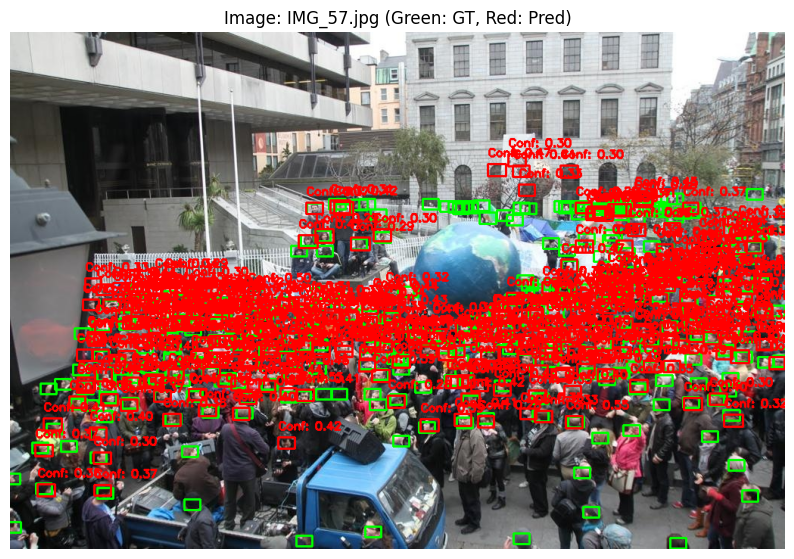

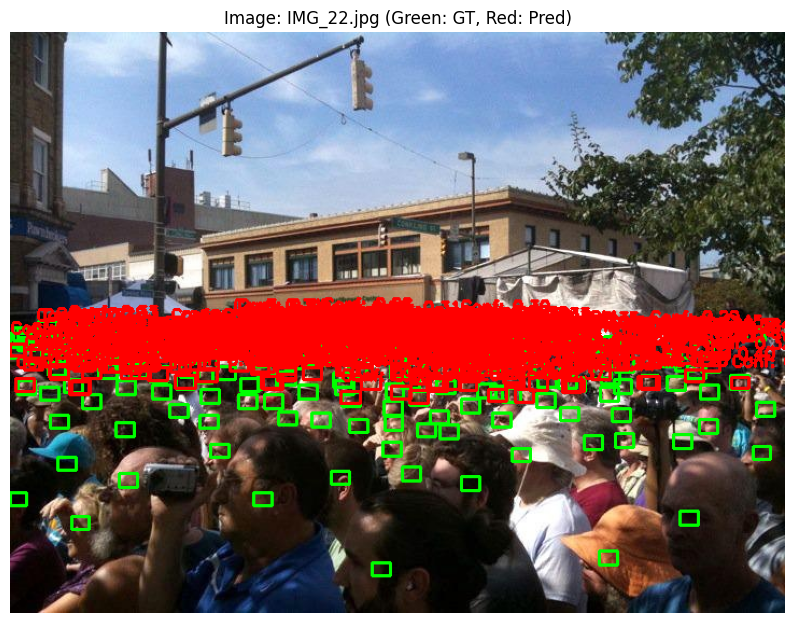

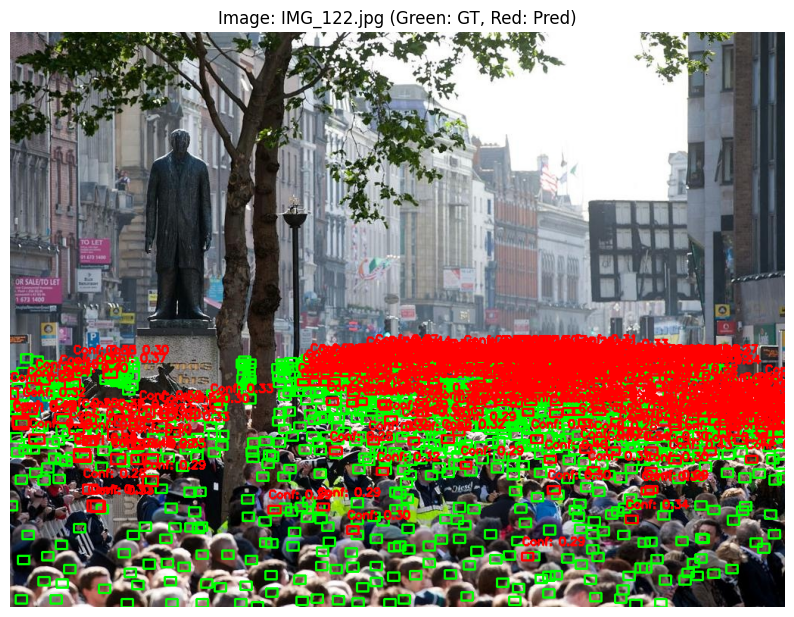

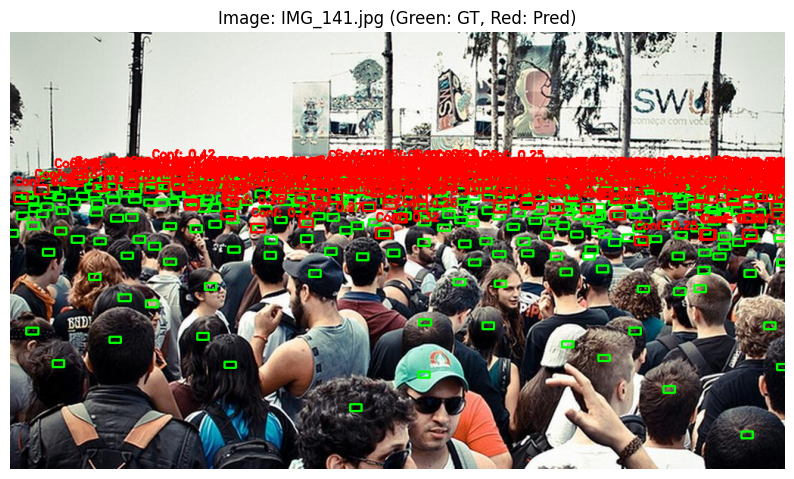

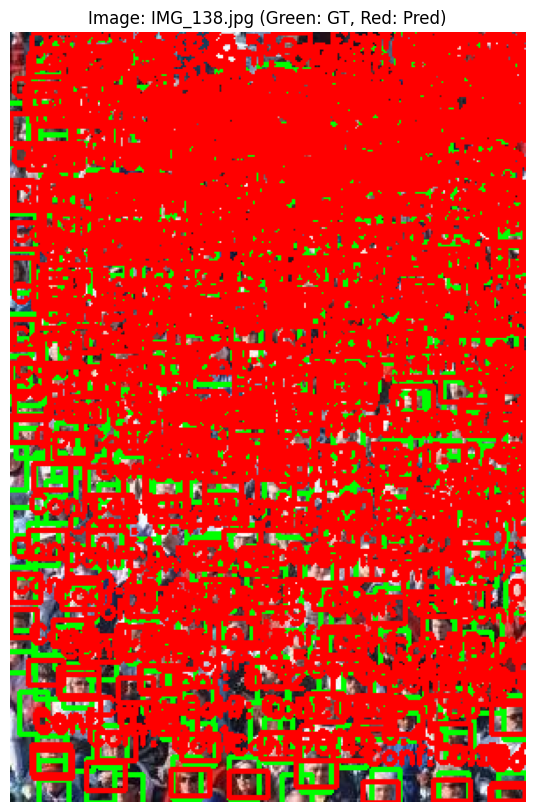

...

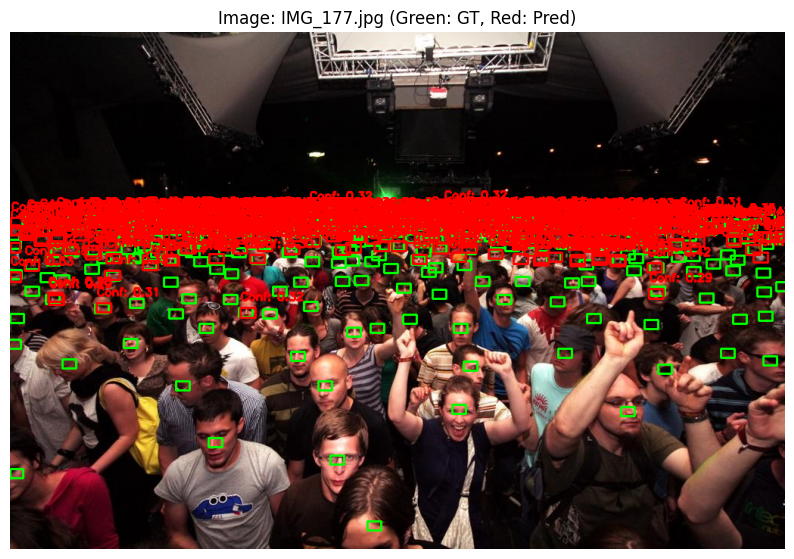

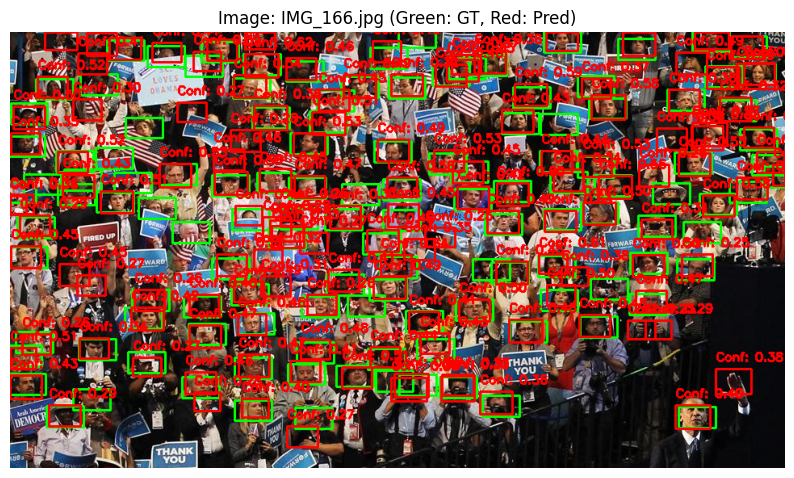

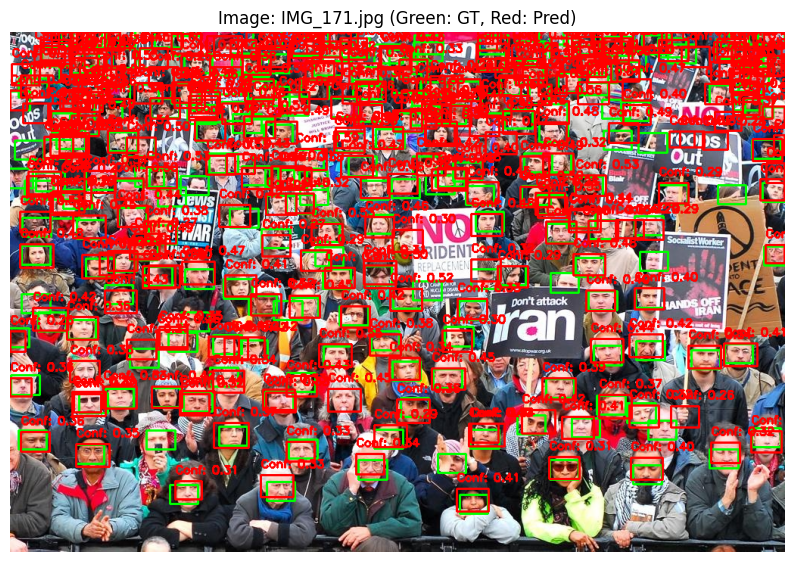

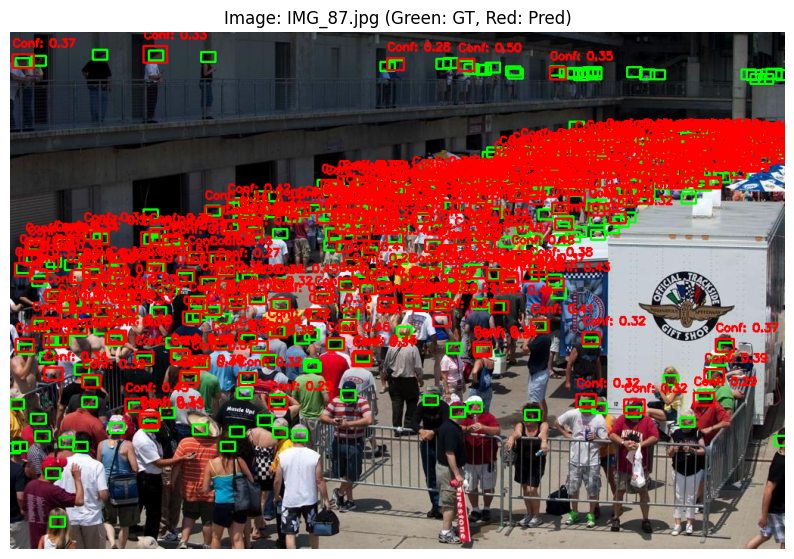

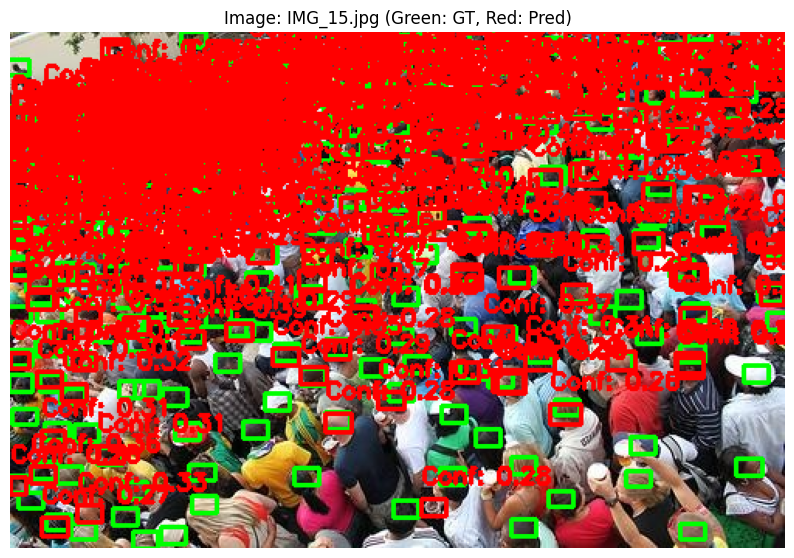

In [6]:
test_img_dir = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test"
test_lbl_dir = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/test"
pred_lbl_dir = "runs/detect/predict/labels"

# Hàm visualize ground-truth và dự đoán
def visualize_predictions(img_dir, gt_dir, pred_dir, num_images=5):
    img_files = [f for f in os.listdir(img_dir) if f.endswith('.jpg')]

    for img_name in img_files[:num_images]:
        # Đọc ảnh
        img_path = os.path.join(img_dir, img_name)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Không thể đọc ảnh {img_path}")
            continue

        h, w = img.shape[:2]

        # Đọc ground-truth
        gt_path = os.path.join(gt_dir, img_name.replace('.jpg', '.txt'))
        gt_boxes = []
        if os.path.exists(gt_path):
            with open(gt_path, 'r') as f:
                gt_boxes = f.readlines()

        # Đọc dự đoán
        pred_path = os.path.join(pred_dir, img_name.replace('.jpg', '.txt'))
        pred_boxes = []
        if os.path.exists(pred_path):
            with open(pred_path, 'r') as f:
                pred_boxes = f.readlines()

        # Vẽ ground-truth (màu xanh lá)
        for box in gt_boxes:
            class_id, x_center, y_center, box_w, box_h = map(float, box.strip().split())
            x_center, y_center, box_w, box_h = x_center * w, y_center * h, box_w * w, box_h * h
            x1, y1 = int(x_center - box_w / 2), int(y_center - box_h / 2)
            x2, y2 = int(x_center + box_w / 2), int(y_center + box_h / 2)
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Vẽ dự đoán (màu đỏ)
        for box in pred_boxes:
            class_id, x_center, y_center, box_w, box_h, conf = map(float, box.strip().split())
            x_center, y_center, box_w, box_h = x_center * w, y_center * h, box_w * w, box_h * h
            x1, y1 = int(x_center - box_w / 2), int(y_center - box_h / 2)
            x2, y2 = int(x_center + box_w / 2), int(y_center + box_h / 2)
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 255), 2)
            cv2.putText(img, f"Conf: {conf:.2f}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10, 10))
        plt.imshow(img_rgb)
        plt.title(f"Image: {img_name} (Green: GT, Red: Pred)")
        plt.axis('off')
        plt.show()

# Visualize 5 ảnh đầu tiên
visualize_predictions(test_img_dir, test_lbl_dir, pred_lbl_dir, num_images=20)

In [ ]:
model = YOLO('runs/train/train2/weights/best.pt')

# Muốn thêm ảnh mới thì để vô
img = cv2.imread('path/to/new/image.jpg')
results = model.predict(img, imgsz=640, conf=0.25)

results[0].show()
print(results[0].boxes.xyxy)

In [8]:
def count_heads_ground_truth(gt_dir):
    total_heads = 0
    for gt_file in os.listdir(gt_dir):
        if not gt_file.endswith('.txt'):
            continue
        gt_path = os.path.join(gt_dir, gt_file)
        with open(gt_path, 'r') as f:
            boxes = f.readlines()
        num_heads = len(boxes)
        print(f"Image {gt_file}: {num_heads} heads (Ground Truth)")
        total_heads += num_heads
    print(f"Total heads in test set (Ground Truth): {total_heads}")

test_lbl_dir = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/test"
count_heads_ground_truth(test_lbl_dir)

# So sánh với dự đoán
count_heads(pred_lbl_dir)

Image IMG_70.txt: 412 heads (Ground Truth)
Image IMG_97.txt: 478 heads (Ground Truth)
Image IMG_166.txt: 126 heads (Ground Truth)
Image IMG_30.txt: 307 heads (Ground Truth)
Image IMG_22.txt: 212 heads (Ground Truth)
Image IMG_81.txt: 356 heads (Ground Truth)
Image IMG_125.txt: 269 heads (Ground Truth)
Image IMG_25.txt: 243 heads (Ground Truth)
Image IMG_179.txt: 400 heads (Ground Truth)
Image IMG_133.txt: 137 heads (Ground Truth)
Image IMG_92.txt: 1366 heads (Ground Truth)
Image IMG_108.txt: 181 heads (Ground Truth)
Image IMG_85.txt: 97 heads (Ground Truth)
Image IMG_156.txt: 199 heads (Ground Truth)
Image IMG_180.txt: 398 heads (Ground Truth)
Image IMG_117.txt: 1603 heads (Ground Truth)
Image IMG_41.txt: 250 heads (Ground Truth)
Image IMG_167.txt: 112 heads (Ground Truth)
Image IMG_29.txt: 309 heads (Ground Truth)
Image IMG_141.txt: 475 heads (Ground Truth)
Image IMG_135.txt: 72 heads (Ground Truth)
Image IMG_49.txt: 514 heads (Ground Truth)
Image IMG_57.txt: 356 heads (Ground Truth)


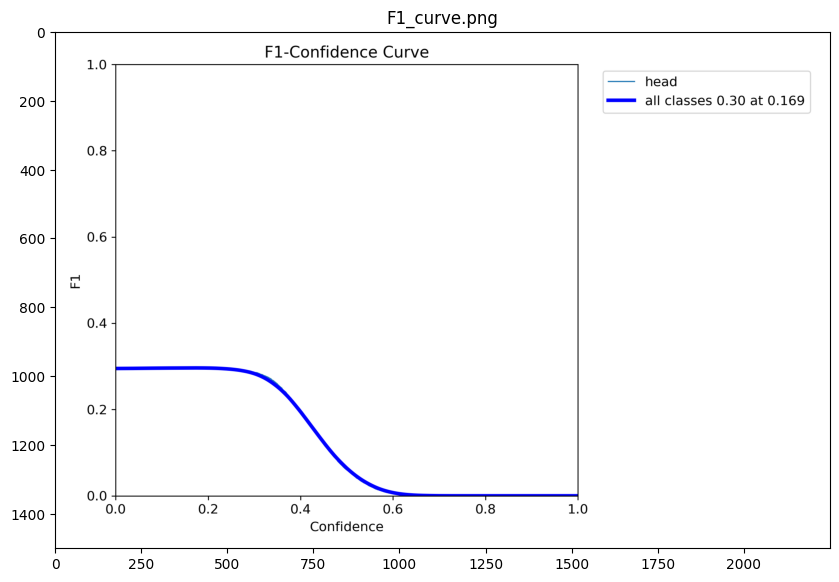

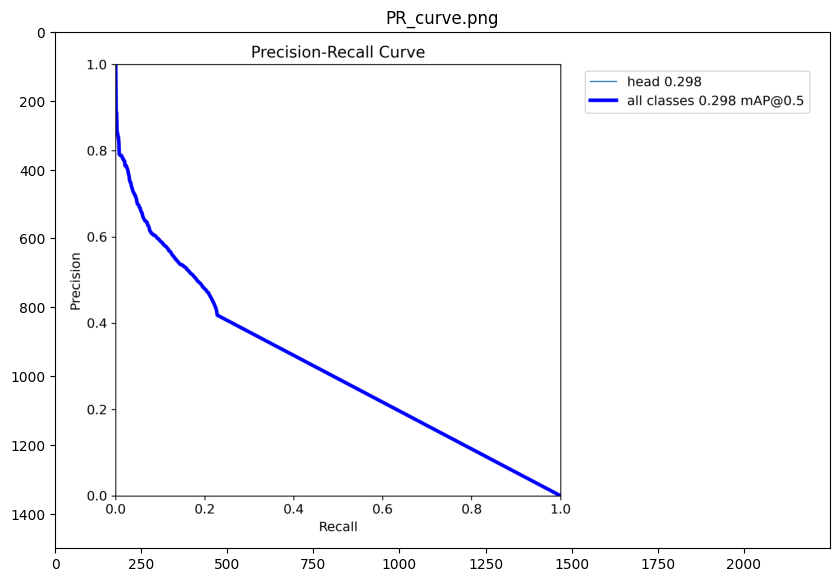

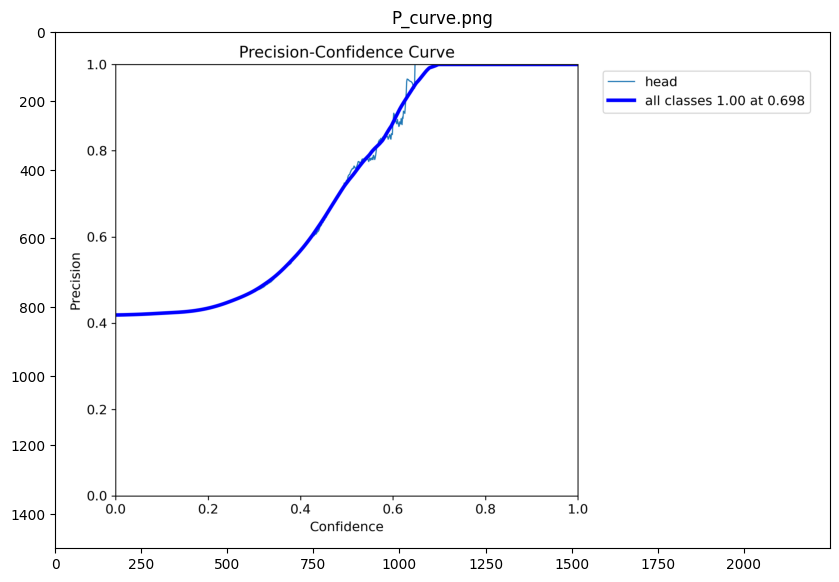

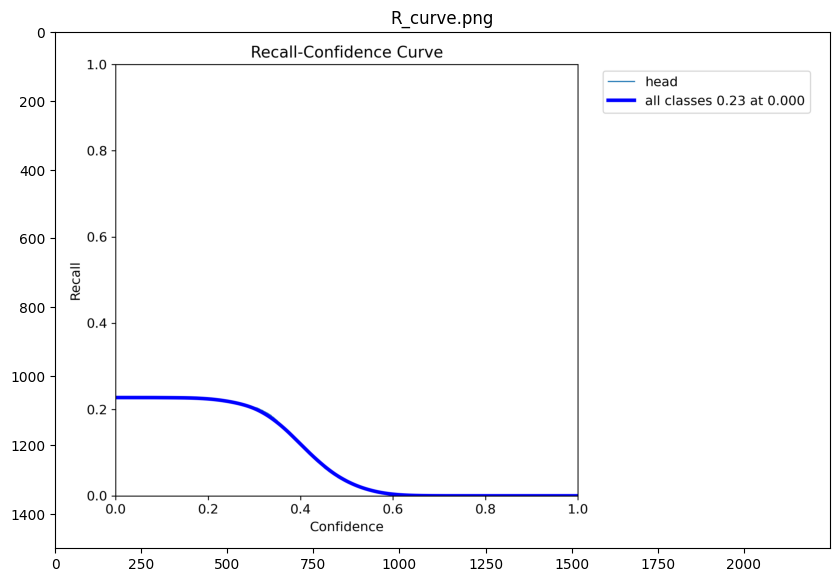

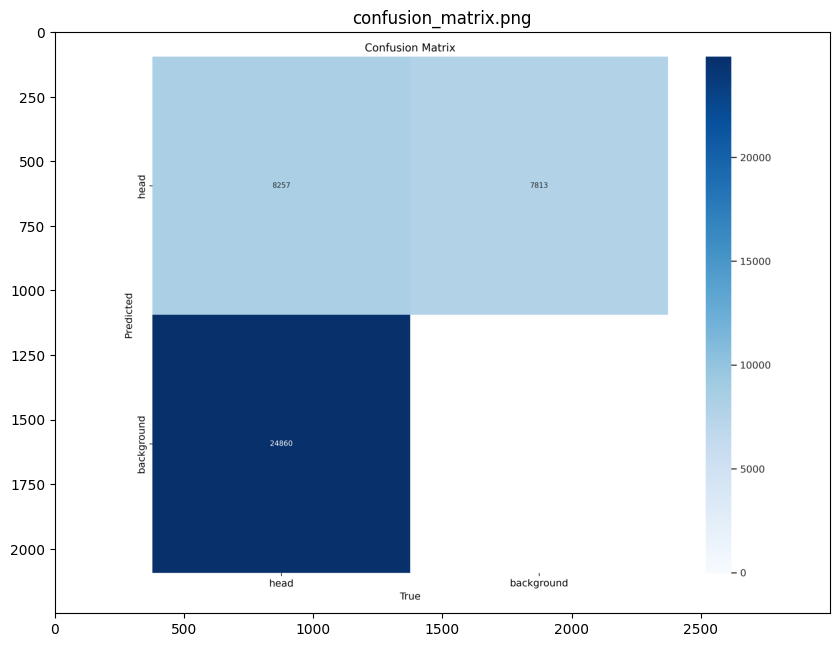

...

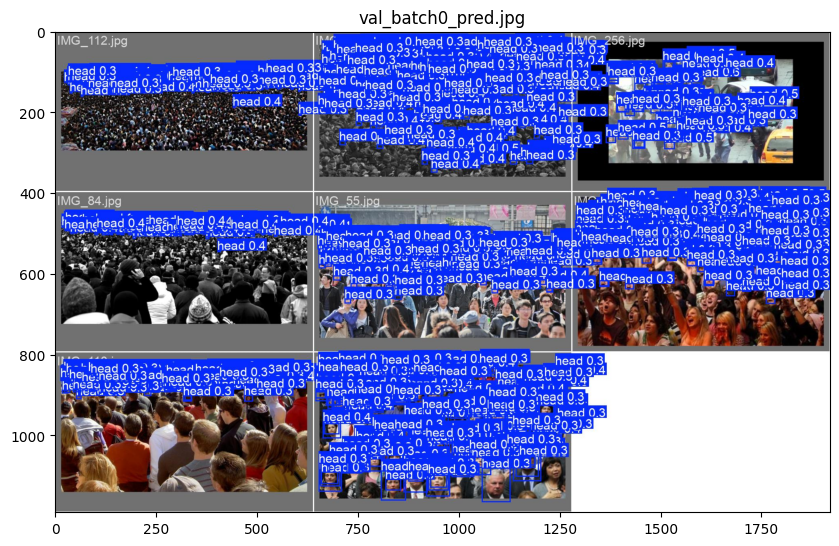

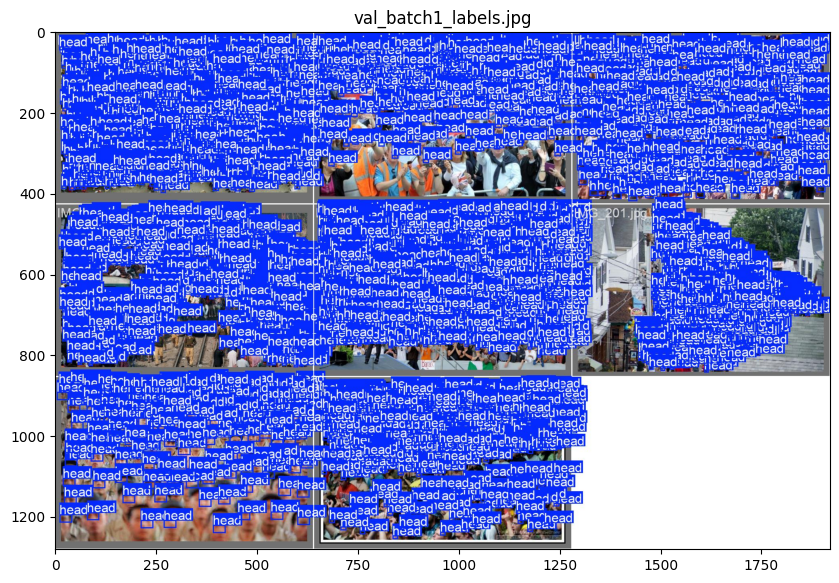

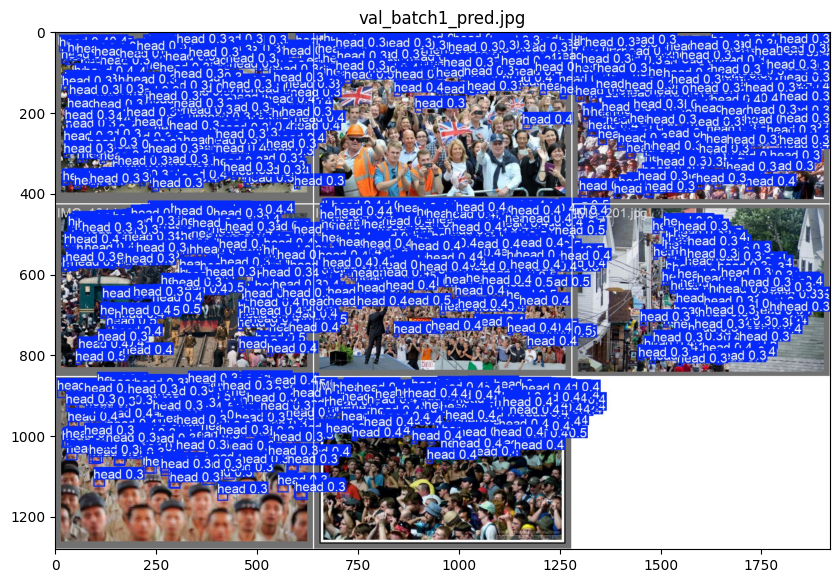

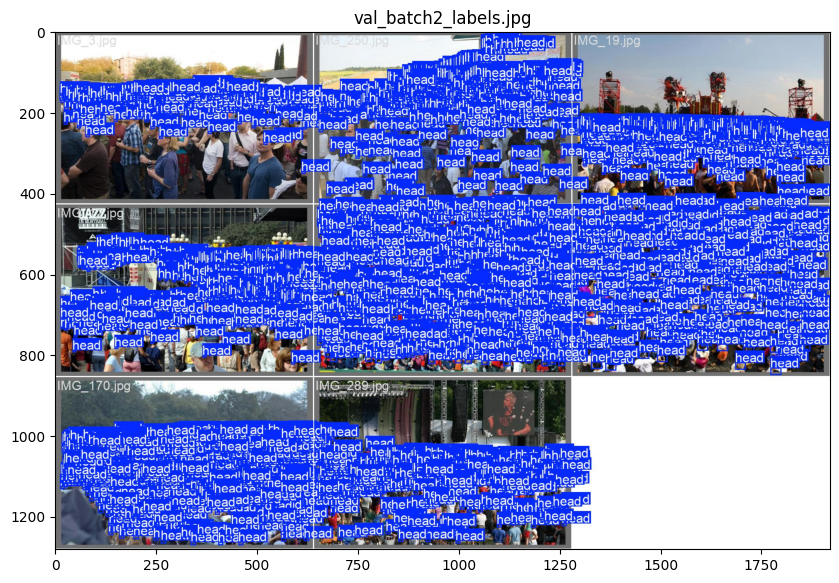

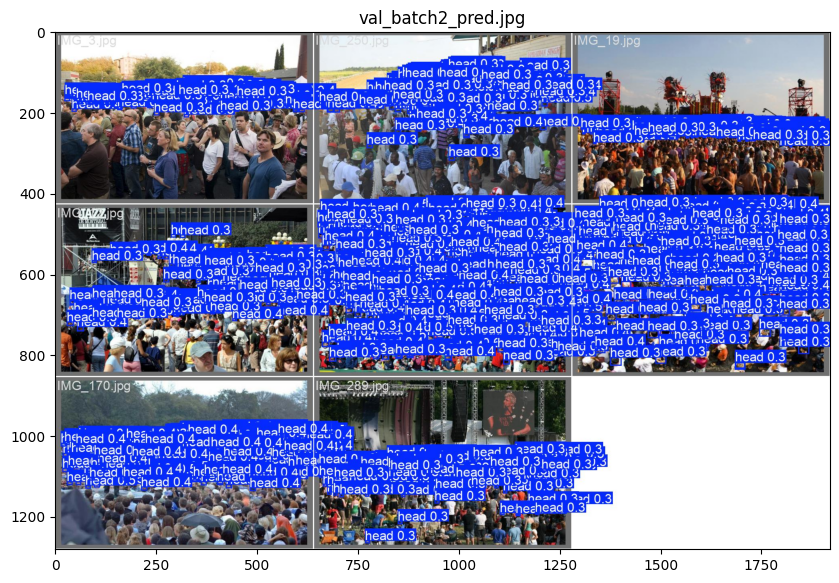

In [9]:
def display_images_from_folder(folder_path):
    image_extensions = ('.png', '.jpg', '.jpeg')
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(image_extensions)]

    image_files.sort()

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = mpimg.imread(image_path)

        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(image_file)
        plt.axis('on')
        plt.show()

folder_path = "runs/detect/train2"

display_images_from_folder(folder_path)

In [10]:
results_df = pd.read_csv("runs/detect/train2/results.csv")
print(results_df)

    epoch       time  train/box_loss  train/cls_loss  train/dfl_loss  \
0       1    27.7833         3.91669         2.24025         1.35857   
1       2    43.0642         3.62759         1.78212         1.20038   
2       3    57.7519         3.57735         1.72624         1.21257   
3       4    74.1279         3.57132         1.68074         1.17201   
4       5    90.5639         3.58323         1.67541         1.17739   
..    ...        ...             ...             ...             ...   
95     96  1504.4200         2.84047         1.31883         1.04870   
96     97  1519.6600         2.82226         1.32911         1.03076   
97     98  1535.3700         2.84498         1.32522         1.03476   
98     99  1550.0300         2.75697         1.33129         1.06074   
99    100  1565.3600         2.80247         1.46240         1.07354   

    metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0                0.19533            0.10617           0.11732   
1    

In [11]:
def print_evaluation_metrics(train_dir):
    results_path = f"{train_dir}/results.csv"
    if not os.path.exists(results_path):
        print(f"File {results_path} không tồn tại. Vui lòng kiểm tra lại thư mục huấn luyện.")
        return
    results_df = pd.read_csv(results_path)
    results_df.columns = results_df.columns.str.strip()
    last_epoch = results_df.iloc[-1]
    print("=== Đánh giá mô hình (Epoch cuối cùng) ===")
    print(f"Precision: {last_epoch['metrics/precision(B)']:.4f}")
    print(f"Recall: {last_epoch['metrics/recall(B)']:.4f}")
    print(f"F1-score (ước lượng): {last_epoch['metrics/precision(B)'] * last_epoch['metrics/recall(B)'] * 2 / (last_epoch['metrics/precision(B)'] + last_epoch['metrics/recall(B)']):.4f}")
    print(f"mAP@50: {last_epoch['metrics/mAP50(B)']:.4f}")
    print(f"mAP@50:95: {last_epoch['metrics/mAP50-95(B)']:.4f}")

    print("\n=== Loss (Epoch cuối cùng) ===")
    print(f"Train Box Loss: {last_epoch['train/box_loss']:.4f}") #Mất mát khi dự đoán vị trí bounding box so với ground truth.
    print(f"Train Class Loss: {last_epoch['train/cls_loss']:.4f}") #Mất mát khi dự đoán vị trí bounding box so với ground truth.
    print(f"Train DFL Loss: {last_epoch['train/dfl_loss']:.4f}")
    #Distribution Focal Loss – là một hàm mất mát được dùng trong việc dự đoán tọa độ bounding box, thay thế cho cách dự đoán tọa độ truyền thống.
    print(f"Validation Box Loss: {last_epoch['val/box_loss']:.4f}")
    print(f"Validation Class Loss: {last_epoch['val/cls_loss']:.4f}")
    print(f"Validation DFL Loss: {last_epoch['val/dfl_loss']:.4f}")

train_dir = "runs/detect/train2"
print_evaluation_metrics(train_dir)

=== Đánh giá mô hình (Epoch cuối cùng) ===
Precision: 0.4429
Recall: 0.2347
F1-score (ước lượng): 0.3068
mAP@50: 0.3125
mAP@50:95: 0.1068

=== Loss (Epoch cuối cùng) ===
Train Box Loss: 2.8025
Train Class Loss: 1.4624
Train DFL Loss: 1.0735
Validation Box Loss: 2.9692
Validation Class Loss: 1.3410
Validation DFL Loss: 1.1235
